In [19]:
include("Harvey_in_Nelson_funcs.jl")
using .julia


In [20]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX


## Estimate

In [21]:
# Specify the file path and sheet name
file_path = "quarterly_gdp.xlsx"
sheet_name = "Quarterly GDP"

# Open the Excel file and load the data from the specified sheet into a DataFrame
data = XLSX.readtable(file_path, sheet_name) |> DataFrame

# Display data
println(data)

# Get the number of observations
num_obs = size(data, 1)
println("Number of observations: ", num_obs)




134×2 DataFrame
 Row │ Date    Value 
     │ Any     Any   
─────┼───────────────
   1 │ 1991K1  364.6
   2 │ 1991K2  364.7
   3 │ 1991K3  368.6
   4 │ 1991K4  364.5
   5 │ 1992K1  371.5
   6 │ 1992K2  367.9
   7 │ 1992K3  377.2
   8 │ 1992K4  375.4
   9 │ 1993K1  371.8
  10 │ 1993K2  370
  11 │ 1993K3  373.2
  12 │ 1993K4  375.7
  13 │ 1994K1  385.1
  14 │ 1994K2  391.5
  15 │ 1994K3  393.3
  16 │ 1994K4  399.8
  17 │ 1995K1  404.2
  18 │ 1995K2  402.5
  19 │ 1995K3  404
  20 │ 1995K4  406.7
  21 │ 1996K1  407.8
  22 │ 1996K2  418.3
  23 │ 1996K3  419
  24 │ 1996K4  419.1
  25 │ 1997K1  424.8
  26 │ 1997K2  431.6
  27 │ 1997K3  429.7
  28 │ 1997K4  430.9
  29 │ 1998K1  437.5
  30 │ 1998K2  434
  31 │ 1998K3  441.2
  32 │ 1998K4  444.1
  33 │ 1999K1  447.8
  34 │ 1999K2  449.8
  35 │ 1999K3  451.7
  36 │ 1999K4  459.7
  37 │ 2000K1  462.9
  38 │ 2000K2  468.1
  39 │ 2000K3  468.9
  40 │ 2000K4  476.5
  41 │ 2001K1  469.1
  42 │ 2001K2  472.2
  43 │ 2001K3  475.3
  44 │ 2001K4  477.7
  

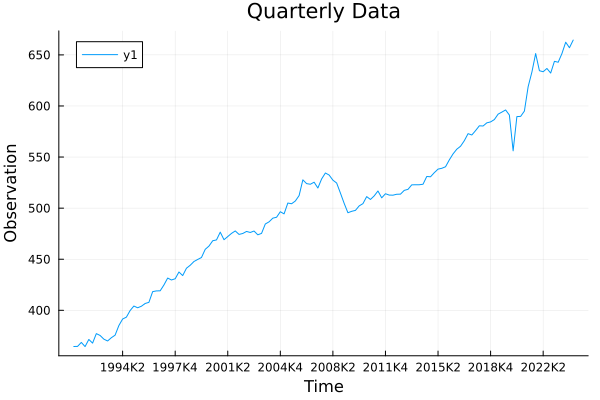

In [22]:
y = data[:, 2]
# y = log.(y)
dates = data[:, 1]

# Plot the data
plot(dates,y, title="Quarterly Data", xlabel="Time", ylabel="Observation")

In [23]:
#Define model
n_order = 2
state_dim = 2+2*n_order
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors

a_rho = 0.01
b_rho = 0.97

a_lambda = 0.01
b_lambda = π

a_xi = 1e-6
b_xi = 1e-6

a_kappa_0 = 1e-6
b_kappa_0 = 1e-6

a_kappa_1 = 1e-6
b_kappa_1 = 1e-6

a_epsilon_0 = 3
b_epsilon_0 = 1

a_epsilon_1 = 3
b_epsilon_1 = 1

a_omega = -100
b_omega = 0

a_p = 0.01
b_p = 0.99

a_q = 0.01
b_q = 0.99

# a_sigma = 1e-6
# b_sigma = 1e-6

priors = [a_rho, b_rho, a_lambda, b_lambda, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon_0, b_epsilon_0, a_epsilon_1, b_epsilon_1, a_omega, b_omega, a_p, b_p, a_q, b_q]




20-element Vector{Float64}:
    0.01
    0.97
    0.01
    3.141592653589793
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    3.0
    1.0
    3.0
    1.0
 -100.0
    0.0
    0.01
    0.99
    0.01
    0.99

In [24]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init, theta_samples_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1, 
    n_order; 
    n_init=80000, 
    burn_init=40000, 
    omega_init=0.08)

Initialization Phase 100%|███████████████████████████████| Time: 0:04:47


Initialization Acceptance Rate: 34.32625 %


([-1.870601602281486 -4.614413463678196 … 1.349045658121568 2.8345482572816043; -1.870601602281486 -4.614413463678196 … 1.349045658121568 2.8345482572816043; … ; -1.484714881442243 -0.8940731060863447 … 1.155919939085187 4.477912782489175; -1.484714881442243 -0.8940731060863447 … 1.155919939085187 4.477912782489175], [0.5040647256466716 -0.030626158081443883 … -0.04091337732062576 -0.0072932726049386686; -0.030626158081443883 1.8372525545118132 … -0.11999287261469233 0.11044940094044714; … ; -0.04091337732062576 -0.11999287261469233 … 0.711739206959869 0.12448542289464236; -0.0072932726049386686 0.11044940094044714 … 0.12448542289464236 0.9604193233585272], 0.3432625, [0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; -1.484714881442243 -0.8940731060863447 … 1.155919939085187 4.477912782489175; -1.484714881442243 -0.8940731060863447 … 1.155919939085187 4.477912782489175], [0.1381332423832413 0.040723391257768984 … 0.7880940899614377 0.9356241557536712; 0.1381332423832413 0.040723391257768984 …

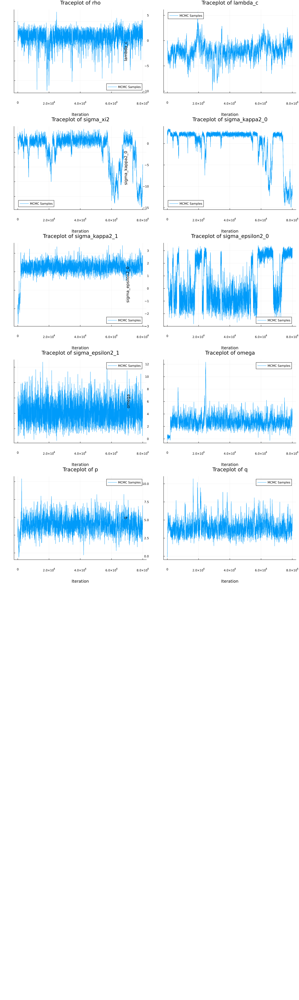

In [25]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots 
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [26]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    n_order, 
    chain_init_burned,
    Sigma; 
    n_rec=20000, 
    burn_rec=10000, 
    omega_rec=0.03)


Recursion Phase   0%|█                                   |  ETA: 0:01:45

Recursion Phase 100%|████████████████████████████████████| Time: 0:01:53


Recursion Acceptance Rate: 23.200000000000003 %


([0.16563912905169004 0.7925978569174774 … 0.5515941728135366 0.9414546384462983; 0.16563912905169004 0.7925978569174774 … 0.5515941728135366 0.9414546384462983; … ; 0.30983686335745325 0.11175631994431635 … 0.8345191005415706 0.9564301208785095; 0.30983686335745325 0.11175631994431635 … 0.8345191005415706 0.9564301208785095], Any[[364.6 0.0 … 0.0 0.0; 364.7934939683306 0.10048791318050779 … -0.0934939683307217 -0.1949866863043058; … ; 659.5738792806736 3.9999318568360733 … -2.5738792806735953 -2.2114079249201306; 664.8142587532101 4.397253454123163 … -0.31425875321020746 0.48056874327924026], [364.6 0.0 … 0.0 0.0; 364.7934939683306 0.10048791318050779 … -0.0934939683307217 -0.1949866863043058; … ; 659.5738792806736 3.9999318568360733 … -2.5738792806735953 -2.2114079249201306; 664.8142587532101 4.397253454123163 … -0.31425875321020746 0.48056874327924026], [364.6 0.0 … 0.0 0.0; 364.7934939683306 0.10048791318050779 … -0.0934939683307217 -0.1949866863043058; … ; 659.5738792806736 3.9999

In [27]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

10

In [28]:


# Number of optimization runs
num_runs = 1

# Parameter names to associate with priors
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

upper_bounds = [1.0, π, Inf, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "rho"
            push!(initial_params, rand(Uniform(a_rho, b_rho)))
        elseif param == "lambda_c"
            push!(initial_params, rand(Uniform(a_lambda, b_lambda)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(a_p, b_p)))
        elseif param == "omega"
            # Normal prior
            push!(initial_params, rand(Normal(-10, 1)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 100000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


Best Estimated Parameters: [0.5265291946833242, 2.8339716644690487, 0.04072870648191667, 0.050935773269429906, 2.847034468188748e-11, 14.551332055476628, 75.78223084724067, -37.13164904217005, 0.9732139479008028, 0.9919673560094122]


In [29]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples = theta_samples_burned[:, i]
    # param_samples = theta_samples_init[:,i]
    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "rho"
        # Uniform prior between 0 and 0.999
        a = a_rho
        b = b_rho
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "lambda_c"
        # Uniform prior between 0 and π
        a = a_lambda
        b = b_lambda
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_0"
        a = a_epsilon_0
        b = b_epsilon_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_1"
        a = a_epsilon_1
        b = b_epsilon_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_y"
        a = a_sigma
        b = b_sigma
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)

    #MLE estimates
    # vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    
 
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
recursion_plot = plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))

savefig(recursion_plot, "Harvey_in_Kim_estimation.png")


"c:\\Users\\marti\\OneDrive - University of Copenhagen\\Økonomi\\9. semester\\Empirical macro\\State-Space-Model-Estimation-1\\Harvey in Kim Nelson\\Harvey_in_Kim_estimation.png"

In [30]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


10-element Vector{Float64}:
   0.20542908894618012
   0.3344163860134747
   0.6804900819206651
   9.373058922347173
 384.7933797349835
   0.5012658932292897
   0.6114078534483642
  -7.796144211543963
   0.7769695659312803
   0.9605378395078307

In [31]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter
,Float64,Float64,String
1,0.205429,0.526529,rho
2,0.334416,2.83397,lambda_c
3,0.68049,0.0407287,sigma_xi2
4,9.37306,0.0509358,sigma_kappa2_0
5,384.793,2.84703e-11,sigma_kappa2_1
6,0.501266,14.5513,sigma_epsilon2_0
7,0.611408,75.7822,sigma_epsilon2_1
8,-7.79614,-37.1316,omega
9,0.77697,0.973214,p


134
134


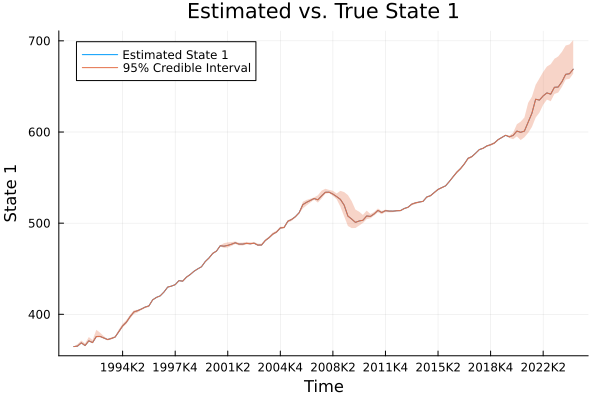

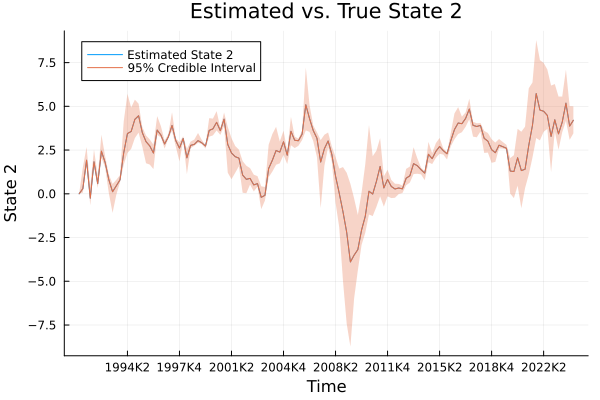

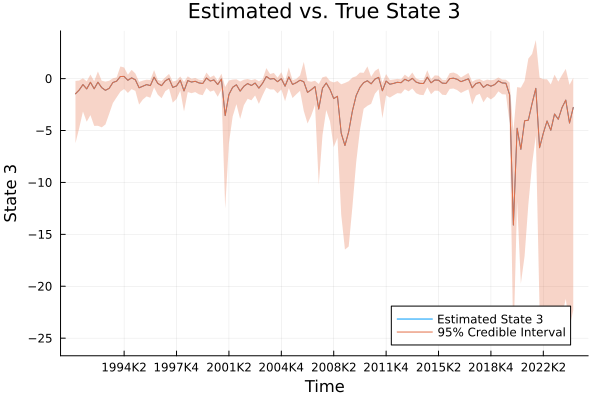

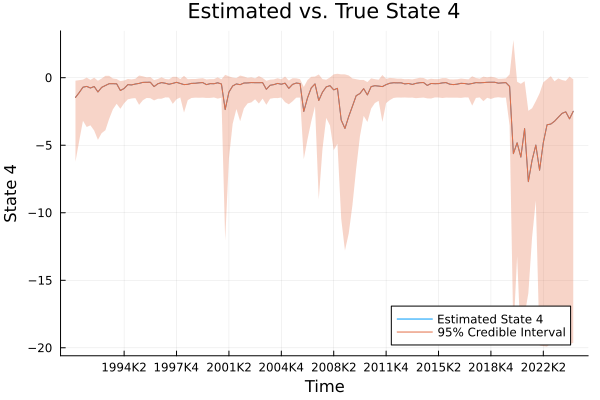

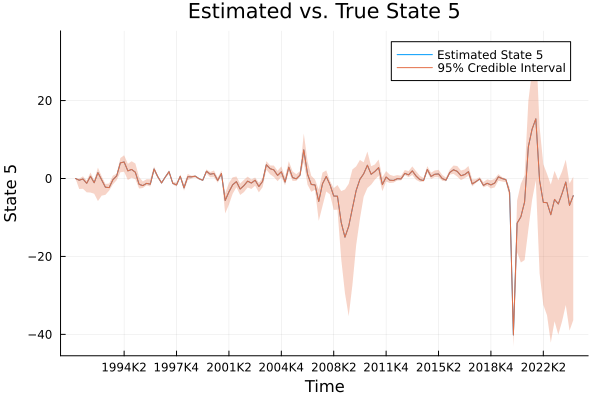

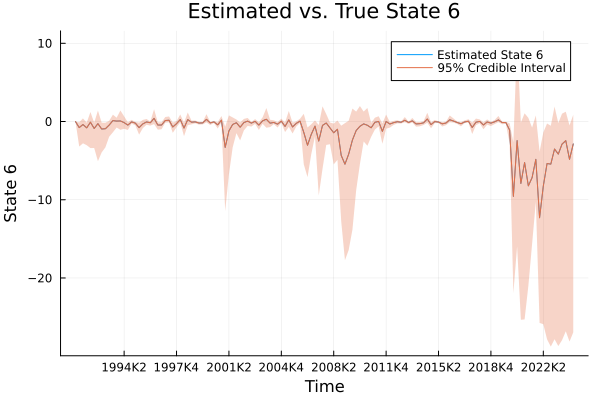

In [32]:
# Collect alpha samples into a 3D array
n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

dates_plot = dates

println(n_time_steps)
println(length(dates_plot))

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)

for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end


# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(dates_plot, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    plot!(dates_plot, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
          alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # # Plot true state (assuming you have `alpha_true` from data simulation)
    # plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


In [33]:
using JLD2

# Save the states to a JLD2 file
@save "states_harvey_in_kim.jld2" alpha_mean alpha_lower alpha_upper



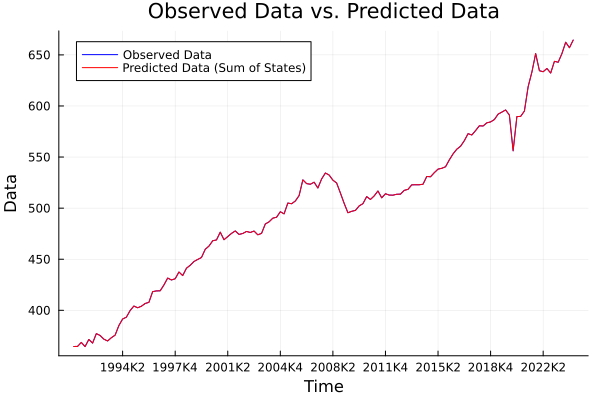

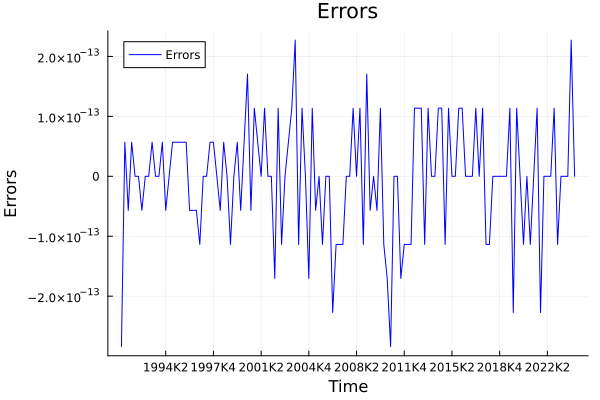

In [34]:
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


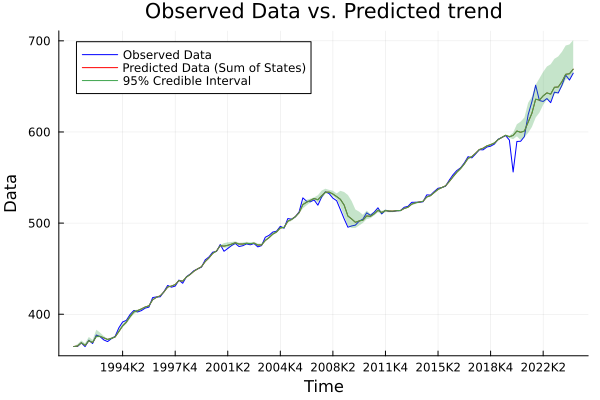

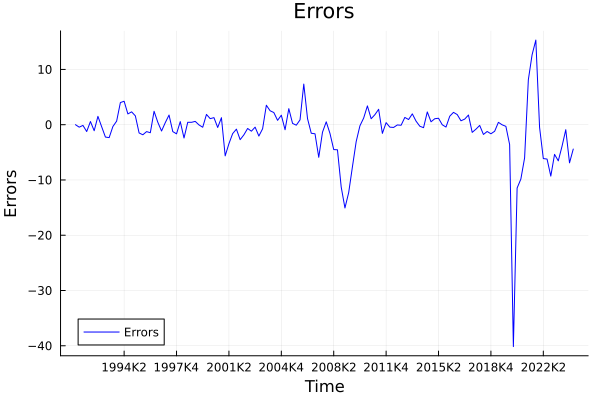

In [35]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted trend")
# Add credible intervals using the `ribbon` argument
plot!(dates_plot, y_pred, ribbon=(alpha_mean[:, state_indices[1]] .- alpha_lower[:, state_indices[1]],
      alpha_upper[:, state_indices[1]] .- alpha_mean[:, state_indices[1]]), fillalpha=0.3, label="95% Credible Interval")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)





## Graphs from MLE estimates


In [36]:
logL, a_mle, p_res_mle = switching_kalman_filter(y, best_params, n_order, alpha_init, P1)

LoadError: UndefVarError: `switching_kalman_filter` not defined

In [ ]:
println(size(a_mle))

(134, 6)


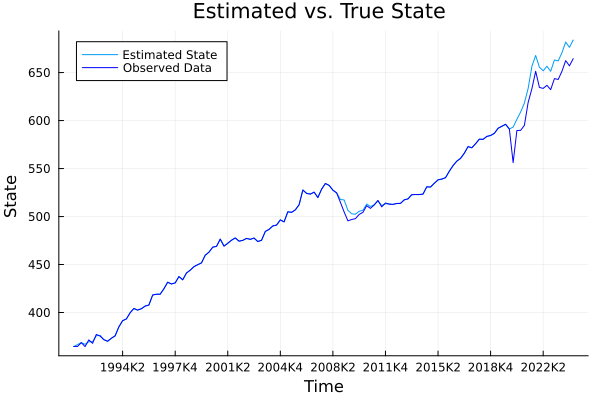

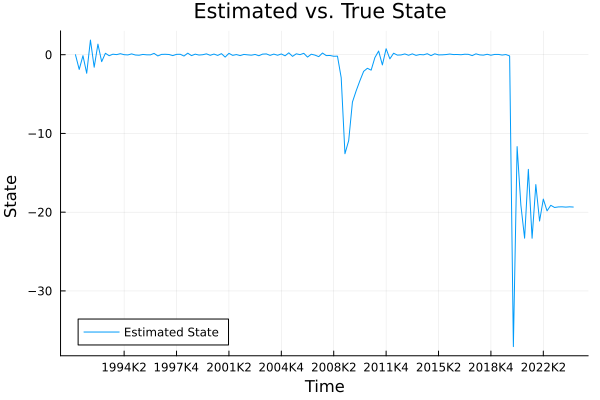

In [ ]:
# Collect alpha samples into a 3D array
n_time_steps = size(alpha_samples[1])
state_dim = size(alpha_samples[2])

dates_plot = dates

p = plot(dates_plot, a_mle[:,1], label="Estimated State ", xlabel="Time",
             ylabel="State ", title="Estimated vs. True State ")

        # add y
        plot!(dates_plot, y, label="Observed Data", color=:blue)
    
    
display(p)

p = plot(dates_plot, a_mle[:,2+2*n_order-1], label="Estimated State ", xlabel="Time",
             ylabel="State ", title="Estimated vs. True State ")
display(p)

    

